In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

import os
import cv2
import uuid
import datetime
import numpy as np
import compress_pickle as cpkl

from ss_baselines.av_nav.config import get_config
from ss_baselines.savi.config.default import get_config as get_savi_config
from ss_baselines.common.env_utils import construct_envs
from ss_baselines.common.environments import get_env_class
from ss_baselines.common.utils import plot_top_down_map

# Helper / tools
from soundspaces.mp3d_utils import CATEGORY_INDEX_MAPPING
def get_category_name(idx):
    assert idx >= 0 and idx <=20, f"Invalid category index number: {idx}"

    for k, v in CATEGORY_INDEX_MAPPING.items():
        if v == idx:
            return k

def get_env_scene_id(envs, env_idx):
    # NOTE: might be different if using other wrapper like SYNC_ENV or VecEnv
    return envs.workers[env_idx]._env._env.current_episode.scene_id.split("/")[3]
    # return envs.workers[env_idx]._env._env._task._sim._current_scene.strip("data/scene_datasets/mp3d").split("/")[0]

def get_current_ep_category_label(obs_dict):
    return get_category_name(obs_dict["category"].argmax())

def save_episode_to_dataset(ep_data_dict, dataset_path):
    if not os.path.exists(dataset_path):
        os.mkdir(dataset_path)
    
    timestamp = datetime.datetime.now().strftime('%Y%m%dT%H%M%S')
    epid = str(uuid.uuid4().hex)
    ep_length = ep_data_dict["ep_length"]

    # TODO: consider the downside of compression if this has to be used for 
    ep_scene_id = ep_data_dict["scene_id"]
    ep_category_name = ep_data_dict["category_name"]

    ep_data_filename = f"{ep_scene_id}-{ep_category_name}-{ep_length}-{timestamp}-{epid}.bz2"
    ep_data_fullpath = os.path.join(dataset_path, ep_data_filename)
    with open(ep_data_fullpath, "wb") as f:
        cpkl.dump(ep_data_dict, f)
    
    return ep_data_filename

def dict_without_keys(d, keys_to_ignore):
    return {x: d[x] for x in d if x not in keys_to_ignore}

/home/rousslan/anaconda3/envs/ss-hab-headless-py39/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Configure the environments for data collection

In [2]:
config = get_savi_config(
    # config_paths="ss_baselines/av_nav/config/audionav/mp3d/env_test_0.yaml", # RGB + AudiogoalSensor
    config_paths="env_configs/savi/savi_ss1.yaml")
config.defrost()
## Seed override
config.SEED = config.TASK_CONFIG.SEED = config.TASK_CONFIG.SIMULATOR.SEED = 100
config.NUM_PROCESSES = 4
config.USE_SYNC_VECENV = True
config.USE_VECENV = False

## Override semantic object sensor sizes: does RGB / Depth sensor's shape increase ?
# config.DISPLAY_RESOLUTION = 512
# config.TASK_CONFIG.TASK.SEMANTIC_OBJECT_SENSOR.HEIGHT = 512
# config.TASK_CONFIG.TASK.SEMANTIC_OBJECT_SENSOR.WIDTH = 512

# For custom resolution, disable the use of pre-rendered observations
config.TASK_CONFIG.SIMULATOR.USE_RENDERED_OBSERVATIONS = False
# For smoother video, set CONTINUOUS_VIEW_CHANGE to True, and get the additional frames in obs_dict["intermediate"]
config.TASK_CONFIG.SIMULATOR.CONTINUOUS_VIEW_CHANGE = False

config.TASK_CONFIG.SIMULATOR.RGB_SENSOR.WIDTH = 512
config.TASK_CONFIG.SIMULATOR.RGB_SENSOR.HEIGHT = 512
config.TASK_CONFIG.SIMULATOR.DEPTH_SENSOR.WIDTH = 512
config.TASK_CONFIG.SIMULATOR.DEPTH_SENSOR.HEIGHT = 512

# Add support for TOP_DOWN_MAP
config.TASK_CONFIG.TASK.MEASUREMENTS.append("TOP_DOWN_MAP")
config.freeze()
# print(config)

print(config)

BASE_TASK_CONFIG_PATH: env_configs/savi/base_semantic_audiogoal.yaml
CHECKPOINT_FOLDER: data/models/output/data
CHECKPOINT_INTERVAL: 50
CMD_TRAILING_OPTS: []
CONTINUOUS: False
DEBUG: False
DISPLAY_RESOLUTION: 128
ENV_NAME: AudioNavRLEnv
EVAL:
  SPLIT: val
  USE_CKPT_CONFIG: True
EVAL_CKPT_PATH_DIR: data/models/output/data
EXTRA_RGB: False
LOG_FILE: data/models/output/train.log
LOG_INTERVAL: 10
MODEL_DIR: data/models/output
NUM_PROCESSES: 4
NUM_UPDATES: 20000
RL:
  DDPPO:
    backbone: custom_resnet18
    distrib_backend: GLOO
    num_recurrent_layers: 1
    pretrained: True
    pretrained_weights: data/models/savi/data/ckpt.XXX.pth
    reset_critic: False
    rnn_type: GRU
    sync_frac: 0.6
  DISTANCE_REWARD_SCALE: 1.0
  PPO:
    BELIEF_PREDICTOR:
      audio_only: False
      current_pred_only: False
      lr: 0.001
      normalize_category_distribution: False
      online_training: True
      train_encoder: False
      use_label_belief: True
      use_location_belief: True
      wei

### Instantiate the environments

In [ ]:
envs = construct_envs(config, get_env_class(config.ENV_NAME))

### Dataset parameterization

In [5]:
DATASET_TOTAL_STEPS = 2500
# DATASET_DIR_PATH = f"SAVI_Oracle_Dataset_2023_05_17__{DATASET_TOTAL_STEPS}__STEPS"
# DATASET_DIR_PATH = f"SAVI_Oracle_Dataset_v0"
DATASET_DIR_PATH = f"SAVI_Oracle_Dataset_v0"

NUM_ENVS = config.NUM_PROCESSES

### Data collection

In [6]:
# # Placeholders for episode data
# obs_list, \
# reward_list, \
# done_list, \
# info_list, \
# action_list, \
# ep_scene_id_list = \
#     [[] for _ in range(NUM_ENVS)], \
#     [[] for _ in range(NUM_ENVS)], \
#     [[] for _ in range(NUM_ENVS)], \
#     [[] for _ in range(NUM_ENVS)], \
#     [[] for _ in range(NUM_ENVS)], \
#     [[] for _ in range(NUM_ENVS)]

# # Plaecholders for various statistics about the training data
# dataset_statistics = {
#     "action_counts": {i: 0 for i in range(4)},
#     "total_steps": 0,
#     "total_episodes": 0,
#     "scene_counts": {},
#     "episode_lengths": [],
#     "category_counts": {get_category_name(i): 0 for i in range(21)}, # 21 categories in SAVi.
#     "cat_scene_filenames": {}, # category -> { scene_id -> [{ep_filename: "", "ep_length": X}]} for easier filtering later
#     "scene_cat_filenames": {}, # scene_id -> {categary -> [{ep_filename: "", "ep_length": X}]} for easier filtering later
# }

# obs, done = envs.reset(), [False for _ in range(NUM_ENVS)]

# step = 0
# ep_returns = []
# envs_current_step = [0 for _ in range(NUM_ENVS)]

# while step < DATASET_TOTAL_STEPS:
#     # Recover the optimal action for each parallel env
#     actions = [envs.workers[i]._env._env._sim._oracle_actions[envs_current_step[i]] for i in range(NUM_ENVS)]

#     # Get current step's meta data
#     envs_scene_ids = [get_env_scene_id(envs, i) for i in range(NUM_ENVS)]
    
#     # Step the environment
#     outputs = envs.step(actions)
#     next_obs, reward, next_done, info = [list(x) for x in zip(*outputs)]

#     # Recorder episode trajectoreis
#     for i in range(NUM_ENVS):
#         obs_list[i].append(obs[i])
#         done_list[i].append(done[i])
#         action_list[i].append(actions[i])
#         reward_list[i].append(reward[i])
#         info_list[i].append(info[i])
#         ep_scene_id_list[i].append(envs_scene_ids[i])

#     # When one or more episode end is detected, write to disk,
#     # then reset the placeholders for the finished env. idx
#     if np.sum(next_done) >= 1.:
#         finished_envs_idxs = np.where(next_done)[0]
    
#         for i in finished_envs_idxs:
#             if not info_list[i][-1]["success"] == 1:
#                 continue
        
#             ep_length = len(obs_list[i])
#             ep_returns = []
#             ep_success = []
#             ep_norm_dist_to_goal = []

#             # Pre-process the obs_dict to have lists of "rgb", "depth", etc..
#             obs_dict = {k: [] for k in obs_list[i][0].keys()} # TODO: to also store intermediate, maaybe use obs_list[i][1].keys() instead

#             # Stores the high resolution rgb and depth data
#             highres_obs_list = {k: [] for k in ["rgb", "depth"]}

#             # TODO: Should not go to ep_lenght but ep_length -1 , since the last step is the first step of the next episode.
#             # Still have to find a way to recover the final, terminal state.
#             for t in range(ep_length):
#                 for k, v in obs_list[i][t].items():
#                     if k in ["rgb", "depth"]:
#                         highres_obs_list[k].append(v.copy()) # TODO: make sure the high res stuff is not resized later
#                         obs_dict[k].append(cv2.resize(v, dsize=(128, 128)))
#                     else:
#                         obs_dict[k].append(v)
                
#                 # Count actions for overall dataset statistics
#                 dataset_statistics["action_counts"][action_list[i][t]] += 1
            
#             # Additional episode metadata
#             # TODO: episode's scene SPLIT
#             # TODO: this probably cause of inconsistent data, because the current state of the env is not necessarily the current scnene, namely since the env has been reset.
#             ep_scene_id = envs_scene_ids[i]
#             ep_category_idx = obs_dict["category"][0].argmax()
#             ep_category_name = get_category_name(ep_category_idx)

#             ep_data_dict = {
#                 "obs_list": obs_dict, # RGB and DEPTH shape (128, 128, 3)
#                 "highres_obs_list": highres_obs_list, # RGB and DEPTH shape (512, 512, 3)
#                 "action_list": action_list[i],
#                 "done_list": done_list[i],
#                 "reward_list": reward_list[i],
#                 "info_list": info_list[i], # This can arguably be skipped ?,
#                 "ep_scene_id_list": ep_scene_id_list[i],
#                 # Other metadata
#                 "ep_length": ep_length,
#                 "scene_id": ep_scene_id,
#                 "category_idx": ep_category_idx,
#                 "category_name": ep_category_name
#             }

#             ep_returns.append(np.sum(reward_list[i]))
#             # TODO: double check why the last info list is not the final one
#             ep_success.append(info_list[i][-1]["success"])
#             ep_norm_dist_to_goal.append(info_list[i][-1]["normalized_distance_to_goal"])

#             # Saves to disk
#             ep_filename = save_episode_to_dataset(ep_data_dict, DATASET_DIR_PATH)

#             step += ep_length

#             # Track overall statistics of the dataset
#             dataset_statistics["total_episodes"] += 1
#             dataset_statistics["total_steps"] += ep_length
#             dataset_statistics["category_counts"][ep_category_name] += 1
#             if ep_scene_id not in dataset_statistics["scene_counts"].keys():
#                 dataset_statistics["scene_counts"][ep_scene_id] = 1
#             else:
#                 dataset_statistics["scene_counts"][ep_scene_id] += 1
#             # Track the lengths of all episodes
#             dataset_statistics["episode_lengths"].append(ep_length)

#             # Add metadata about episode grouped by categories, then scenes
#             if ep_category_name not in dataset_statistics["cat_scene_filenames"].keys():
#                 dataset_statistics["cat_scene_filenames"][ep_category_name] = {}
#             if ep_scene_id not in dataset_statistics["cat_scene_filenames"][ep_category_name].keys():
#                 dataset_statistics["cat_scene_filenames"][ep_category_name][ep_scene_id] = []
#             dataset_statistics["cat_scene_filenames"][ep_category_name][ep_scene_id].append(
#                 {"ep_filename": ep_filename, "ep_length": ep_length})

#             # Add metadata about episodes grouped by scene ids, then categories
#             if ep_scene_id not in dataset_statistics["scene_cat_filenames"].keys():
#                 dataset_statistics["scene_cat_filenames"][ep_scene_id] = {}
#             if ep_category_name not in dataset_statistics["scene_cat_filenames"][ep_scene_id].keys():
#                 dataset_statistics["scene_cat_filenames"][ep_scene_id][ep_category_name] = []
#             dataset_statistics["scene_cat_filenames"][ep_scene_id][ep_category_name].append(
#                 {"ep_filename": ep_filename, "ep_length": ep_length})

#             # Reset the data placeholders
#             obs_list[i], action_list[i], done_list[i], reward_list[i], info_list[i], ep_scene_id_list[i] = \
#                 [], [], [], [], [], []
        
#             # Save the dataset statistics to file
#             ## Compute action probs
#             dataset_statistics["action_probs"] = {
#                 a: dataset_statistics["action_counts"][a] / dataset_statistics["total_steps"] for a in range(4)
#             }
#             dataset_statistics["action_cel_coefs"] = {
#                 k: (0.25 / v) if v > 0 else 0. for k, v in dataset_statistics["action_probs"].items()
#             }

#             ## Compute action coefficient for CEL of BC
#             dataset_stats_filename = "dataset_statistics.bz2"
#             dataset_stats_filepath = f"{DATASET_DIR_PATH}/{dataset_stats_filename}"
#             with open(dataset_stats_filepath, "wb") as f:
#                 cpkl.dump(dataset_statistics, f)

#             for k, v in dataset_statistics.items():
#                 print(f"{k}: {v}")

#             print("")
#             print("#####################################################################################")
#             print("#####################################################################################")
#             print(f"Collected {step} / {DATASET_TOTAL_STEPS}; Avg return: {np.mean(ep_returns):0.2f}; Avg Suc.: {np.mean(ep_success)}; Avg: Norm Dist Goal: {np.mean(ep_norm_dist_to_goal)}")
#             print("#####################################################################################")
#             print("#####################################################################################")
#             print("")

#     # Prepare for the next step
#     obs = next_obs
#     done = next_done

#     for i in range(NUM_ENVS):
#         envs_current_step[i] = int((1 - next_done[i]) * (envs_current_step[i] + 1))

#     # Stop collection ASAP
#     if step >= DATASET_TOTAL_STEPS:
#         break

## Checking dataset statistics

In [7]:
dataset_stats_filepath = f"{DATASET_DIR_PATH}/dataset_statistics.bz2"
with open(dataset_stats_filepath, "rb") as f:
    r__dataset_stats = cpkl.load(f)

from pprint import pprint
pprint(dict_without_keys(r__dataset_stats, ["cat_scene_filenames", "scene_cat_filenames"]))

{'action_cel_coefs': {0: 5.192401960784314,
                      1: 0.3584299128669317,
                      2: 2.185146982980918,
                      3: 1.7862563237774032},
 'action_counts': {0: 1632, 1: 23642, 2: 3878, 3: 4744},
 'action_probs': {0: 0.04814727401463299,
                  1: 0.6974864290771773,
                  2: 0.1144087797970262,
                  3: 0.13995751711116355},
 'category_counts': {'bathtub': 7,
                     'bed': 30,
                     'cabinet': 127,
                     'chair': 433,
                     'chest_of_drawers': 45,
                     'clothes': 16,
                     'counter': 53,
                     'cushion': 181,
                     'fireplace': 23,
                     'gym_equipment': 14,
                     'picture': 195,
                     'plant': 75,
                     'seating': 24,
                     'shower': 22,
                     'sink': 40,
                     'sofa': 88,
                

In [8]:
# Check the category -> scene -> filenames
for category, scene_filenames in r__dataset_stats["cat_scene_filenames"].items():
    print(f"{category}:")
    for scene, filenames in scene_filenames.items():
        print(f"\t{scene}: {len(filenames)}")

plant:
	gTV8FGcVJC9: 8
	Vvot9Ly1tCj: 19
	b8cTxDM8gDG: 16
	vyrNrziPKCB: 13
	D7N2EKCX4Sj: 4
	759xd9YjKW5: 6
	VzqfbhrpDEA: 6
	ac26ZMwG7aT: 1
	ZMojNkEp431: 2
counter:
	5LpN3gDmAk7: 4
	ac26ZMwG7aT: 10
	VzqfbhrpDEA: 10
	b8cTxDM8gDG: 11
	rPc6DW4iMge: 3
	gTV8FGcVJC9: 4
	ZMojNkEp431: 4
	D7N2EKCX4Sj: 1
	vyrNrziPKCB: 1
	Vvot9Ly1tCj: 2
	759xd9YjKW5: 3
tv_monitor:
	vyrNrziPKCB: 2
	rPc6DW4iMge: 1
	VzqfbhrpDEA: 1
	ZMojNkEp431: 9
	5LpN3gDmAk7: 6
	gTV8FGcVJC9: 3
	ac26ZMwG7aT: 1
	759xd9YjKW5: 2
	Vvot9Ly1tCj: 2
bed:
	b8cTxDM8gDG: 3
	vyrNrziPKCB: 7
	gTV8FGcVJC9: 5
	rPc6DW4iMge: 5
	Vvot9Ly1tCj: 1
	ac26ZMwG7aT: 5
	ZMojNkEp431: 2
	5LpN3gDmAk7: 2
picture:
	gTV8FGcVJC9: 17
	D7N2EKCX4Sj: 21
	5LpN3gDmAk7: 32
	vyrNrziPKCB: 19
	ac26ZMwG7aT: 23
	rPc6DW4iMge: 25
	VzqfbhrpDEA: 27
	759xd9YjKW5: 9
	Vvot9Ly1tCj: 7
	b8cTxDM8gDG: 11
	PuKPg4mmafe: 2
	ZMojNkEp431: 2
cabinet:
	rPc6DW4iMge: 14
	gTV8FGcVJC9: 23
	vyrNrziPKCB: 5
	PuKPg4mmafe: 5
	b8cTxDM8gDG: 21
	ac26ZMwG7aT: 21
	Vvot9Ly1tCj: 5
	759xd9YjKW5: 8
	5LpN3gDmAk7: 6
	Vz

In [9]:
# Check the scene -> category -> filenames
for scene, category_filenames in r__dataset_stats["scene_cat_filenames"].items():
    print(f"{scene}:")
    for category, filenames in category_filenames.items():
        print(f"\t{category}: {len(filenames)}")

gTV8FGcVJC9:
	plant: 8
	picture: 17
	cabinet: 23
	chair: 19
	chest_of_drawers: 3
	sink: 4
	bed: 5
	gym_equipment: 2
	counter: 4
	tv_monitor: 3
	bathtub: 1
	shower: 3
	table: 6
	cushion: 7
	sofa: 2
	fireplace: 6
	toilet: 2
5LpN3gDmAk7:
	counter: 4
	cushion: 35
	chair: 28
	picture: 32
	table: 9
	sofa: 8
	towel: 6
	toilet: 2
	cabinet: 6
	sink: 4
	seating: 4
	tv_monitor: 6
	chest_of_drawers: 4
	stool: 4
	bathtub: 4
	bed: 2
vyrNrziPKCB:
	tv_monitor: 2
	cabinet: 5
	picture: 19
	plant: 13
	table: 5
	bed: 7
	chair: 2
	cushion: 10
	sofa: 5
	gym_equipment: 2
	shower: 6
	fireplace: 2
	clothes: 2
	toilet: 3
	counter: 1
	sink: 3
	chest_of_drawers: 1
b8cTxDM8gDG:
	bed: 3
	sofa: 10
	cushion: 39
	chair: 51
	cabinet: 21
	plant: 16
	table: 21
	counter: 11
	picture: 11
	towel: 3
	sink: 5
Vvot9Ly1tCj:
	plant: 19
	cushion: 18
	towel: 4
	sofa: 6
	chair: 22
	bed: 1
	cabinet: 5
	sink: 4
	table: 6
	chest_of_drawers: 4
	picture: 7
	shower: 2
	toilet: 1
	tv_monitor: 2
	counter: 2
rPc6DW4iMge:
	cabinet: 14
	chair

In [23]:
edd["info_list"][0].keys()

dict_keys(['distance_to_goal', 'normalized_distance_to_goal', 'success', 'spl', 'softspl', 'na', 'sna', 'sws', 'top_down_map'])

29hnd4uzFmX:
	chair: 6
Ep. scene: 29hnd4uzFmX | Cat. : chair | Len. : 11
Ep. Scene Ids:, ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX'] --- ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX']

Ep. scene: 29hnd4uzFmX | Cat. : chair | Len. : 7
Ep. Scene Ids:, ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX'] --- ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX']

Ep. scene: 29hnd4uzFmX | Cat. : chair | Len. : 12
Ep. Scene Ids:, ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX'] --- ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX']

Ep. scene: 29hnd4uzFmX | Cat. : chair | Len. : 8
Ep. Scene Ids:, ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX'] --- ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX']

Ep. scene: 29hnd4uzFmX | Cat. : chair | Len. : 12
Ep. Scene Ids:, ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX'] --- ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX']

Ep. scene: 29hnd4uzFmX | Cat. : chair | Len. : 11
Ep. Scene Ids:, ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX'] --- ['29hnd4uzFmX', '29hnd4uzFmX', '29hnd4uzFmX']

	

/tmp/ipykernel_1547685/378318185.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = plt.subplots(1, N * 2 + 1, figsize=(4 * N * 2 + 4, 4), dpi=300)


Ep. scene: SN83YJsR3w2 | Cat. : chair | Len. : 25
Ep. Scene Ids:, ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2'] --- ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2']

Ep. scene: SN83YJsR3w2 | Cat. : chair | Len. : 11
Ep. Scene Ids:, ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2'] --- ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2']

Ep. scene: SN83YJsR3w2 | Cat. : chair | Len. : 31
Ep. Scene Ids:, ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2'] --- ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2']

Ep. scene: SN83YJsR3w2 | Cat. : chair | Len. : 26
Ep. Scene Ids:, ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2'] --- ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2']

Ep. scene: SN83YJsR3w2 | Cat. : chair | Len. : 10
Ep. Scene Ids:, ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2'] --- ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2']

Ep. scene: SN83YJsR3w2 | Cat. : chair | Len. : 25
Ep. Scene Ids:, ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2'] --- ['SN83YJsR3w2', 'SN83YJsR3w2', 'SN83YJsR3w2']

	picture: 2
Ep. scene:

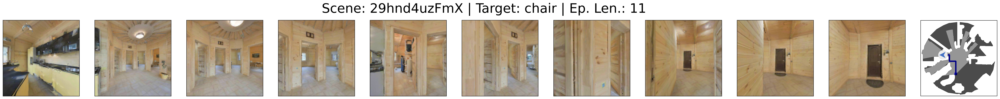

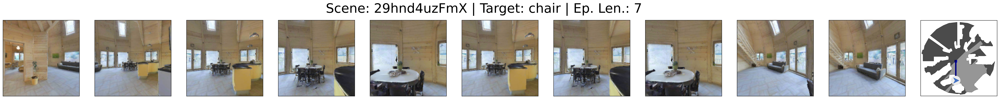

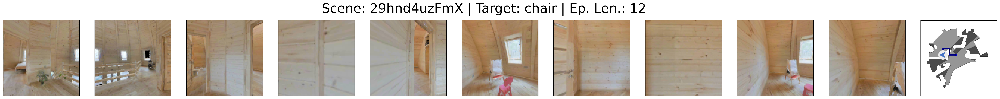

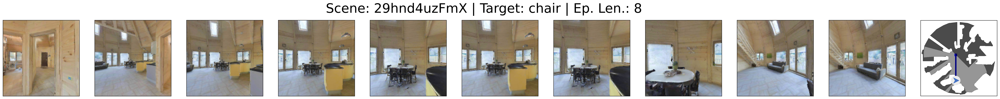

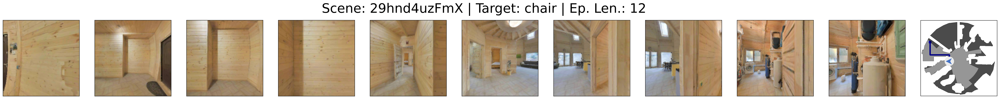

...

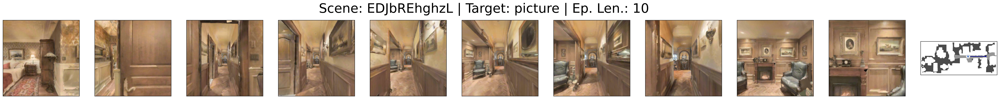

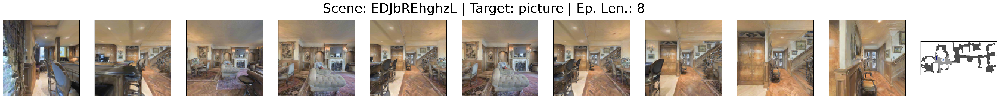

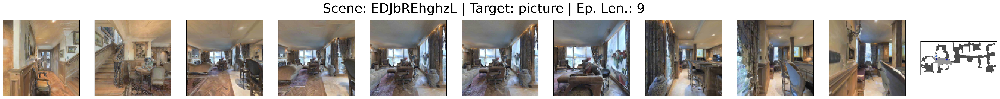

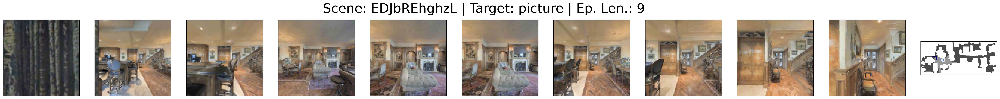

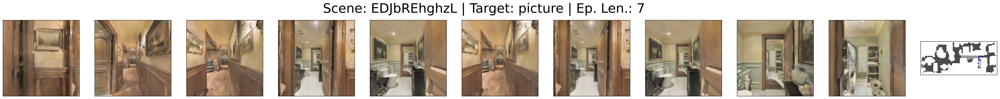

In [26]:
# Plot the trajectories scene wise
NN = 35 # Max trajs to plot
n_trajs_plotted = 0
CATEGORIES_OF_INTEREST = ["picture", "chair"]

for scene, category_filenames in r__dataset_stats["scene_cat_filenames"].items():
    print(f"{scene}:")
    for category, filenames in category_filenames.items():
        if category not in CATEGORIES_OF_INTEREST:
            continue

        print(f"\t{category}: {len(filenames)}")

        for ep_filename_data in filenames:
            ep_filename = ep_filename_data["ep_filename"]

            # relative file path
            ep_filepath = f"{DATASET_DIR_PATH}/{ep_filename}"

            # Load the episode data
            with open(ep_filepath, "rb") as f:
                edd = cpkl.load(f)

            ## Plot the collected trajectory's RGB observations
            ep_length = len(edd["obs_list"]["rgb"])
            ep_category_name = edd["category_name"]
            ep_scene_id = edd["scene_id"]

            print(f"Ep. scene: {ep_scene_id} | Cat. : {ep_category_name} | Len. : {ep_length}")
            print(f"Ep. Scene Ids:, {edd['ep_scene_id_list'][:3]} --- {edd['ep_scene_id_list'][-3:]}")
            print("")

            
            N = 5
            truncated_obs_list = edd["obs_list"]["rgb"][:N] + edd["obs_list"]["rgb"][-N:]
            truncated_info_list = edd["info_list"][:N] + edd["info_list"][-N:]

            fig, axes = plt.subplots(1, N * 2 + 1, figsize=(4 * N * 2 + 4, 4), dpi=300)
            fig.set_facecolor("white")

            # RGB focused plot
            for t, rgb_obs in enumerate(truncated_obs_list):
                axes[t].tick_params(axis="both", which="both", bottom=False, top=False, left=False, labelleft=False, labelbottom=False)
                axes[t].imshow(rgb_obs)
            top_down_map_img = plot_top_down_map(edd["info_list"][-3])
            axes[-1].imshow(top_down_map_img)
            axes[-1].tick_params(axis="both", which="both", bottom=False, top=False, left=False, labelleft=False, labelbottom=False)

            # Top down map focused plot
            # for t, info_dict in enumerate(truncated_info_list):
            #     axes[t].tick_params(axis="both", which="both", bottom=False, top=False, left=False, labelleft=False, labelbottom=False)
            #     top_down_map_img = plot_top_down_map(info_dict)
            #     axes[t].imshow(top_down_map_img)
            #     # axes[t].imshow(info_dict["top_down_map"]["map"])
            # axes[-1].imshow(truncated_obs_list[0])
            # axes[-1].tick_params(axis="both", which="both", bottom=False, top=False, left=False, labelleft=False, labelbottom=False)

            fig.suptitle(f"Scene: {ep_scene_id} | Target: {ep_category_name} | Ep. Len.: {ep_length}", fontsize=32)

            n_trajs_plotted += 1

            if n_trajs_plotted >= NN:
                break

        if n_trajs_plotted >= NN:
            break
    
    if n_trajs_plotted >= NN:
        break

## Checking collected trajectories

In [ ]:
ep_filepath = f"{DATASET_DIR_PATH}/" + \
    "1pXnuDYAj8r-bed-20-20230522T153938-a334babf79314450b2006dc10b045960.bz2"

with open(ep_filepath, "rb") as f:
    edd = cpkl.load(f)

print(f"edd content: {list(edd.keys())}")
# edd["obs_list"].keys() # dict_keys(['depth', 'rgb', 'audiogoal', 'spectrogram', 'category', 'pointgoal_with_gps_compass', 'pose'])
# type(edd["obs_list"]["rgb"]), len(edd["obs_list"]["rgb"]), edd["obs_list"]["rgb"][0].shape

In [ ]:
for k,v in edd["obs_list"].items():
    print(f"{k}: {v[0].shape}")
print(f"action: {np.shape(edd['action_list'])}")
print(f"done: {np.shape(edd['done_list'])}")
print(f"reward: {np.shape(edd['reward_list'])}")

In [ ]:
# DATASET_PATH="SAVI_Oracle_Dataset_2023_05_17__50__STEPS"
DATASET_PATH="SAVI_Oracle_Dataset_v0_2.5K"
for ep_filename in os.listdir(DATASET_PATH)[:25]:
    if ep_filename == "dataset_statistics.bz2":
        continue
    
    # relative file path
    ep_filepath = f"{DATASET_PATH}/{ep_filename}"
    
    # Load the episode data
    with open(ep_filepath, "rb") as f:
        edd = cpkl.load(f)

    ## Plot the collected trajectory's RGB observations
    ep_length = len(edd["obs_list"]["rgb"])
    ep_category_name = edd["category_name"]
    ep_scene_id = edd["scene_id"]

    print(f"Ep. scene: {ep_scene_id} | Cat. : {ep_category_name} | Len. : {ep_length}")
    print(f"Ep. Scene Ids:, {edd['ep_scene_id_list'][-3:]}")
    print("")

    
    N = 5
    truncated_obs_list = edd["obs_list"]["rgb"][:N] + edd["obs_list"]["rgb"][-N:]
    truncated_info_list = edd["info_list"][:N] + edd["info_list"][:N]
    fig, axes = plt.subplots(1, N * 2 + 1, figsize=(4 * N * 2 + 4, 4), dpi=300)
    fig.set_facecolor("white")

    for t, rgb_obs in enumerate(truncated_obs_list):
        axes[t].tick_params(axis="both", which="both", bottom=False, top=False, left=False, labelleft=False, labelbottom=False)
        axes[t].imshow(rgb_obs)
    top_down_map_img = plot_top_down_map(edd["info_list"][-3])
    axes[-1].imshow(top_down_map_img)
    axes[-1].tick_params(axis="both", which="both", bottom=False, top=False, left=False, labelleft=False, labelbottom=False)

    fig.suptitle(f"Scene: {ep_scene_id} | Target: {ep_category_name} | Ep. Len.: {ep_length}", fontsize=32)